In [35]:
import requests
import pandas as pd
import numpy as np
import math

import matplotlib.pyplot as plt
# import seaborn as sns
import graphing

import plotly.express as px

import plotly.graph_objects as go


from datetime import datetime



import statsmodels.formula.api as smf
# import missingno as msno
# from m1b_gradient_descent import gradient_descent
from sklearn.model_selection import train_test_split, GridSearchCV

from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier, export_text, plot_tree

from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, RandomForestClassifier


from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler

from sklearn.metrics import confusion_matrix, classification_report, log_loss, mean_squared_error, mean_absolute_error, r2_score, make_scorer, balanced_accuracy_score

In [36]:
import matplotlib
print(matplotlib.__version__)

3.10.0


In [37]:
def download_file(url, filename):
    # Send a GET request to the URL
    response = requests.get(url)
    
    # Check if the request was successful
    response.raise_for_status()  # This will raise an exception for HTTP errors
    
    # Write the content to a file
    with open(filename, 'wb') as f:
        f.write(response.content)


In [38]:
url_1 = r"https://raw.githubusercontent.com/MicrosoftDocs/mslearn-introduction-to-machine-learning/main/Data/san_fran_crime.csv"


download_file(url_1, 'san_fran_crime.csv')

In [39]:
#Import the data from the .csv file
dataset = pd.read_csv('san_fran_crime.csv', delimiter="\t")

#Let's have a look at the data and the relationship we are going to model
print(dataset.head())
print(dataset.shape)

       Category  DayOfWeek  PdDistrict  Resolution           X          Y  \
0   WEAPON LAWS          5    SOUTHERN        True -122.403405  37.775421   
1   WEAPON LAWS          5    SOUTHERN        True -122.403405  37.775421   
2      WARRANTS          1     BAYVIEW        True -122.388856  37.729981   
3  NON-CRIMINAL          2  TENDERLOIN       False -122.412971  37.785788   
4  NON-CRIMINAL          5     MISSION       False -122.419672  37.765050   

   day_of_year  time_in_hours  
0           29      11.000000  
1           29      11.000000  
2          116      14.983333  
3            5      23.833333  
4            1       0.500000  
(150431, 8)


In [40]:
import graphing # custom graphing code. See our GitHub repo for details
import numpy as np

# Crime category
graphing.multiple_histogram(dataset, label_x='Category', label_group="Resolution", histfunc='sum', show=True)

# District
graphing.multiple_histogram(dataset, label_group="Resolution", label_x="PdDistrict", show=True)

# Map of crimes
graphing.scatter_2D(dataset, label_x="X", label_y="Y", label_colour="Resolution", title="GPS Coordinates", size_multiplier=0.8, show=True)

# Day of the week
graphing.multiple_histogram(dataset, label_group="Resolution", label_x="DayOfWeek", show=True)

# day of the year
# For graphing we simplify this to week or the graph becomes overwhelmed with bars
dataset["week_of_year"] = np.round(dataset.day_of_year / 7.0)
graphing.multiple_histogram(dataset, 
                    label_x='week_of_year',
                    label_group='Resolution',
                    histfunc='sum', show=True)
del dataset["week_of_year"]

In [41]:
def create_grouped_histogram(
    df,
    x_column,
    color_column,
    y_column=None,
    histfunc='count',
    nbins=None,
    title=None
):
    """
    Creates a grouped histogram using Plotly Express.
    
    Parameters:
    df: pandas DataFrame containing the data
    x_column: Column to bin on the x-axis
    color_column: Column to group/color by
    y_column: Optional column to aggregate (if None, counts occurrences)
    histfunc: Aggregation function ('count', 'sum', 'avg', etc.)
    nbins: Number of bins (None for automatic binning)
    title: Plot title
    
    Returns:
    plotly Figure object
    """
    fig = px.histogram(
        df,
        x=x_column,
        color=color_column,  # This creates separate traces for each group
        y=y_column,         # Optional: column to aggregate
        histfunc=histfunc,  # How to aggregate y values
        nbins=nbins,        # Number of bins
        title=title,
        barmode='group'     # Places bars next to each other
    )
    
    return fig

In [42]:
# Create a simple count-based histogram
fig1 = create_grouped_histogram(
    dataset,
    x_column='Category',
    color_column='Resolution',
    title='Distribution by Category'
)

fig1.show()

In [43]:
px.scatter(dataset, x="X", y="Y", color="Resolution", title="GPS Coordinates").update_traces(marker=dict(size=3))


In [44]:
# Seaborn's scatterplot function
# plt.figure(figsize=(12, 6))
# sns.scatterplot(data=dataset, 
#                 x="X", 
#                 y="Y", 
#                 hue="Resolution",  # This is like 'color' in plotly
#                 s=5)             # 's' controls the size (area in points^2)
# plt.title("GPS Coordinates")
# plt.show()

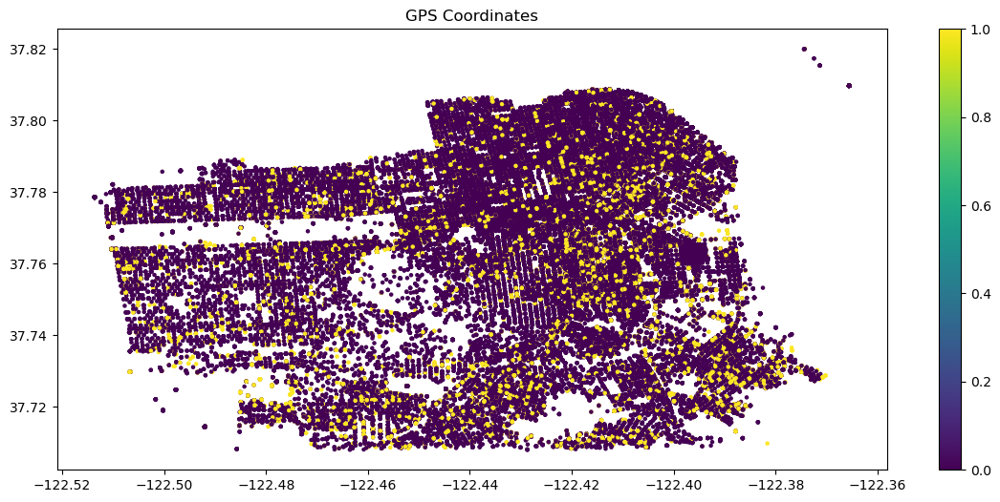

In [45]:
plt.figure(figsize=(14, 6))  # Set the figure size
plt.scatter(dataset["X"], 
           dataset["Y"], 
           c=dataset["Resolution"],  # 'c' is for color mapping
           s=5)                     # 's' for size (area in points^2)
plt.title("GPS Coordinates")
plt.colorbar()  # Adds a color scale
plt.show()

## Finalizing Data preparation

Let's finalize our data preparation by one-hot encoding our categorical features:

In [46]:
# One-hot encode categorical features
dataset = pd.get_dummies(dataset, columns=["Category", "PdDistrict"], drop_first=False)

print(dataset.head())

   DayOfWeek  Resolution           X          Y  day_of_year  time_in_hours  \
0          5        True -122.403405  37.775421           29      11.000000   
1          5        True -122.403405  37.775421           29      11.000000   
2          1        True -122.388856  37.729981          116      14.983333   
3          2       False -122.412971  37.785788            5      23.833333   
4          5       False -122.419672  37.765050            1       0.500000   

   Category_ARSON  Category_ASSAULT  Category_BAD CHECKS  Category_BRIBERY  \
0           False             False                False             False   
1           False             False                False             False   
2           False             False                False             False   
3           False             False                False             False   
4           False             False                False             False   

   ...  PdDistrict_BAYVIEW  PdDistrict_CENTRAL  PdDistri

In [47]:
# Split the dataset in an 90/10 train/test ratio. 
# We can afford to do this here because our dataset is very very large
# Normally we would choose a more even ratio
train, test = train_test_split(dataset, test_size=0.1, random_state=2, shuffle=True)

print("Data shape:")
print("train", train.shape)
print("test", test.shape)

Data shape:
train (135387, 54)
test (15044, 54)


## Model assessment code

We'll fit several models here, so to maximize code reuse, we'll make a dedicated method that trains a model and then tests it.

Our test stage uses a metric called "balanced accuracy," which we'll refer to as "accuracy" for short throughout this exercise. It's not critical that you understand this metric for these exercises, but in essence this is between `0` and `1`:
* `0` means no answers were correct
* `1` means all answers were correct

Balanced accuracy takes into account that our data set has more unresolved than resolved crimes. We'll cover what this means in later learning material in this course.

In [48]:

# Make a utility method that we can re-use throughout this exercise
# To easily fit and test out model

features = [c for c in dataset.columns if c != "Resolution"]


# def fit_and_test_model(model):
#     '''
#     Trains a model and tests it against both train and test sets
#     '''  
#     global features

#     # Train the model
#     model.fit(train[features], train.Resolution)

#     # Assess its performance
#     # -- Train
#     predictions = model.predict(train[features])
#     train_accuracy = balanced_accuracy_score(train.Resolution, predictions)

#     # -- Test
#     predictions = model.predict(test[features])
#     test_accuracy = balanced_accuracy_score(train.Resolution, predictions)

#     return train_accuracy, test_accuracy


# print("Ready to go!")



def fit_and_test_model(model):
    '''
    Trains a model and tests it against both train and test sets
    '''  
    global features

    # Train the model
    model.fit(train[features], train.Resolution)

    # Assess its performance
    # -- Train
    train_predictions = model.predict(train[features])
    train_accuracy = balanced_accuracy_score(train.Resolution, train_predictions)

    # -- Test
    test_predictions = model.predict(test[features])
    # Fix: Compare with test.Resolution instead of train.Resolution
    test_accuracy = balanced_accuracy_score(test.Resolution, test_predictions)

    return train_accuracy, test_accuracy

In [49]:
# fit a simple tree using only three levels
model = DecisionTreeClassifier(random_state=2, max_depth=4) 
train_accuracy, test_accuracy = fit_and_test_model(model)

print("Model trained!")
print("Train accuracy", train_accuracy)
print("Test accuracy", test_accuracy)

Model trained!
Train accuracy 0.7266118203124867
Test accuracy 0.7215563988692366


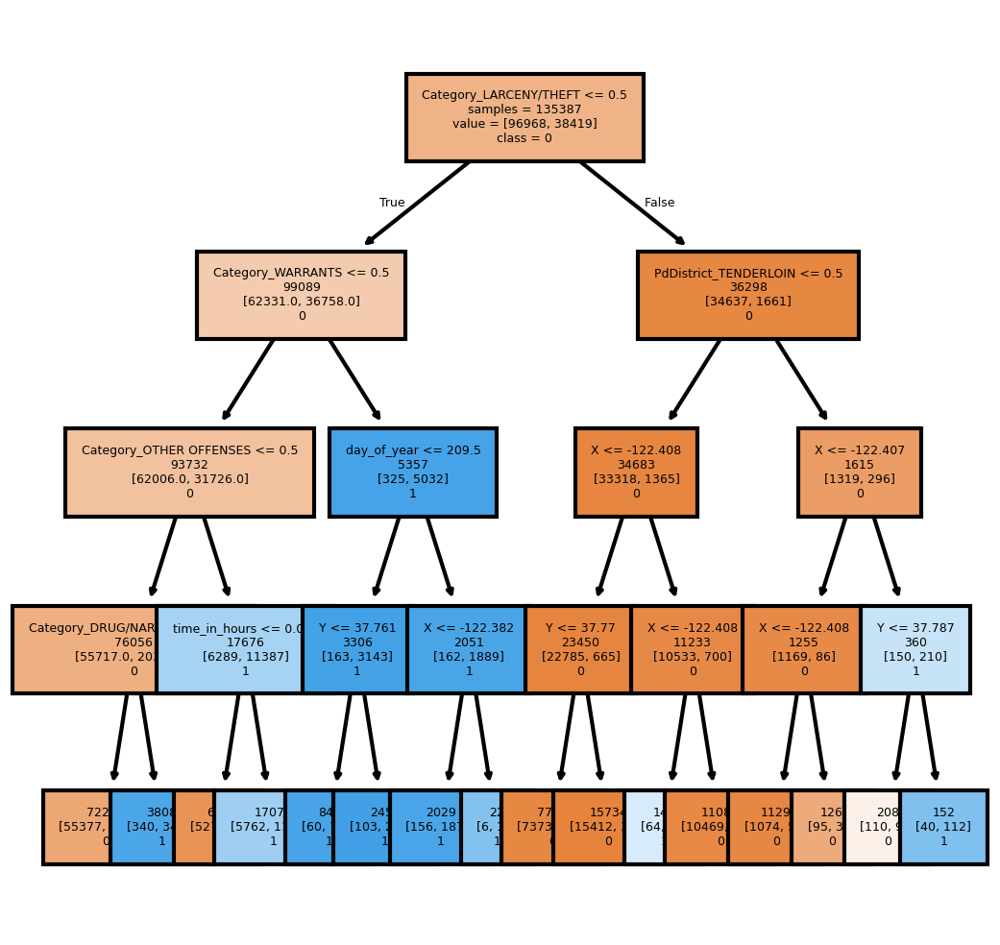

In [50]:
plot = plt.subplots(figsize = (4,4), dpi=300)[0]
plot = plot_tree(model,
                fontsize=3,
                feature_names = features, 
                class_names = ['0','1'], # class_names in ascending numerical order 
                label="root",
                impurity=False,
                filled=True) 
plt.show()

All of the blue-colored boxes correspond to prediction that a crime would be resolved. 

Take a look at the tree to learn what it thinks are important for predicting an outcome. Compare this to the graphs we made earlier. Can you see a relationship between the two?

The score we have isn't bad, but the tree is pretty simple. Let's see if we can do better.

## Improving performance through architecture

We will try and improve our model's performance by changing its architecture. Let's focus on the ``maximum_depth`` parameter. 

Our previous tree was relatively simple and shallow with a ``maximum_depth = 3``. Let's see what happens if we increase it to 100:

In [51]:
# fit a very deep tree
model = DecisionTreeClassifier(random_state=1, max_depth=100)

train_accuracy, test_accuracy = fit_and_test_model(model)
print("Train accuracy", train_accuracy)
print("Test accuracy", test_accuracy)

Train accuracy 0.9995864881946777
Test accuracy 0.7767968524220694


As you can imagine, a tree with a ``maximum_depth = 100`` is big. In fact, it's too big to visualize here, so let's jump straight into seeing how the new model works on our training data.

Both the training and test accuracy have increased a lot. The training, however, has increased much more. While we're happy with the improvement in test accuracy, this is a clear sign of _overfitting_.

Overfitting with decision trees becomes even more obvious when we have more typical (smaller) sized datasets. Let's rerun the previous exercise but with only 100 training samples:

In [52]:
# Temporarily shrink the training set to something
# more realistic
full_training_set = train
train = train[:100]

# fit the same tree as before
model = DecisionTreeClassifier(random_state=1, max_depth=100)

# Assess on the same test set as before
train_accuracy, test_accuracy = fit_and_test_model(model)
print("Train accuracy", train_accuracy)
print("Test accuracy", test_accuracy)

# Roll the training set back to the full set
train = full_training_set

Train accuracy 1.0
Test accuracy 0.5850645895576951


The model performs badly on the test data. With reasonable sized datasets, _decision trees_ are notoriously prone to _overfitting_. In other words, they tend to fit very well to the data on which they're trained, but generalize very poorly to unknown data. This gets worse the deeper the tree gets or the smaller the training set gets. Let's see if we can mitigate this.

## Pruning a tree

_Pruning_ is the process of simplifying a _decision tree_ so that it gives the best classification results while simultaneously reducing overfitting. There are two types of pruning: _pre-pruning_ and _post-pruning_. 

_Pre-pruning_ involves restricting the model during training so that it doesn't grow larger than is useful. We will cover this below.

_Post-pruning_ is when we simplify the tree after training it. It doesn't involve making any design decisions ahead of time, but simply optimizing the existing model. This is a valid technique but is quite involved, and so we won't cover it here due time constraints.

## Prepruning

We can perform pre-pruning by generating many models, each with different ``max_depth`` parameters. For each, we're recording the _balanced accuracy_ for the _test set_. To show that this is important even with quite large datasets, we'll work with 10,000 samples here.

In [53]:
# Temporarily shrink the training set to 10000
# for this exercise to see how pruning is important
# even with moderately large datasets
full_training_set = train
train = train[:10000]


# Loop through the values below and build a model
# each time, setting the maximum depth to that value 
max_depth_range = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10 ,15, 20, 50, 100]
accuracy_trainset = []
accuracy_testset = []
for depth in max_depth_range:
    # Create and fit the model
    prune_model =DecisionTreeClassifier(random_state=1, max_depth=depth)

    # Calculate and record its sensitivity
    train_accuracy, test_accuracy = fit_and_test_model(prune_model)
    accuracy_trainset.append(train_accuracy)
    accuracy_testset.append(test_accuracy)

# Plot the sensitivity as a function of depth  
pruned_plot = pd.DataFrame(dict(max_depth=max_depth_range, accuracy=accuracy_trainset))

fig = graphing.line_2D(dict(train=accuracy_trainset, test=accuracy_testset), x_range=max_depth_range, show=True)

# Roll the training set back to the full thing
train = full_training_set

We can see from our plot that the best _accuracy_ is obtained for a ``max_depth`` of about 10. We're looking to simplify our tree, so we pick ``max_depth = 10`` for our final _pruned_ tree:

In [54]:
# Temporarily shrink the training set to 10000
# for this exercise to see how pruning is important
# even with moderately large datasets
full_training_set = train
train = train[:10000]


# Not-pruned
model = DecisionTreeClassifier(random_state=1)
train_accuracy, test_accuracy = fit_and_test_model(model)
print("Unpruned Train accuracy", train_accuracy)
print("Unpruned Test accuracy", test_accuracy)


# re-fit our final tree to print out its performance
model = DecisionTreeClassifier(random_state=1, max_depth=10)
train_accuracy, test_accuracy = fit_and_test_model(model)
print("Train accuracy", train_accuracy)
print("Test accuracy", test_accuracy)

# Roll the training set back to the full thing
train = full_training_set

Unpruned Train accuracy 0.9996434937611408
Unpruned Test accuracy 0.7219189452075965
Train accuracy 0.8016027915999302
Test accuracy 0.7437900187051387


In [55]:
# Import the data from the .csv file
dataset = pd.read_csv('san_fran_crime.csv', delimiter="\t")

# Remember to one-hot encode our crime and PdDistrict variables 
categorical_features = ["Category", "PdDistrict"]
dataset = pd.get_dummies(dataset, columns=categorical_features, drop_first=False)

# Split the dataset in an 90/10 train/test ratio. 
# Recall that our dataset is very large so we can afford to do this
# with only 10% entering the test set
train, test = train_test_split(dataset, test_size=0.1, random_state=2, shuffle=True)

# Let's have a look at the data and the relationship we are going to model
print(dataset.head())
print("train shape:", train.shape)
print("test shape:", test.shape)

   DayOfWeek  Resolution           X          Y  day_of_year  time_in_hours  \
0          5        True -122.403405  37.775421           29      11.000000   
1          5        True -122.403405  37.775421           29      11.000000   
2          1        True -122.388856  37.729981          116      14.983333   
3          2       False -122.412971  37.785788            5      23.833333   
4          5       False -122.419672  37.765050            1       0.500000   

   Category_ARSON  Category_ASSAULT  Category_BAD CHECKS  Category_BRIBERY  \
0           False             False                False             False   
1           False             False                False             False   
2           False             False                False             False   
3           False             False                False             False   
4           False             False                False             False   

   ...  PdDistrict_BAYVIEW  PdDistrict_CENTRAL  PdDistri

Hopefully this looks familiar to you! If not, jump back and go through the previous exercise on decision trees.

## Model assessment code

We'll use the same model assessment code as we did in the previous exercise.

In [56]:
# Make a utility method that we can re-use throughout this exercise
# To easily fit and test out model

features = [c for c in dataset.columns if c != "Resolution"]

def fit_and_test_model(model):
    '''
    Trains a model and tests it against both train and test sets
    '''  
    global features

    # Train the model
    model.fit(train[features], train.Resolution)

    # Assess its performance
    # -- Train
    predictions = model.predict(train[features])
    train_accuracy = balanced_accuracy_score(train.Resolution, predictions)

    # -- Test
    predictions = model.predict(test[features])
    test_accuracy = balanced_accuracy_score(test.Resolution, predictions)

    return train_accuracy, test_accuracy


print("Ready to go!")

Ready to go!


## Decision tree

Let's quickly train a reasonably well-tuned decision tree to remind ourselves of its performance:

In [57]:
# re-fit our last decision tree to print out its performance
model = DecisionTreeClassifier(random_state=1, max_depth=10) 

dt_train_accuracy, dt_test_accuracy = fit_and_test_model(model)

print("Decision Tree Performance:")
print("Train accuracy", dt_train_accuracy)
print("Test accuracy", dt_test_accuracy)

Decision Tree Performance:
Train accuracy 0.7742407145595661
Test accuracy 0.7597105242913844


## Random Forest

A random forest is a collection of decision trees that work together to calculate the label for a sample.

Trees in a random forest are trained independently, on different partitions of data, and thus develop different biases; but when combined, they're less likely to overfit the data.

Let's build a very simple forest with two trees and the *default* parameters:

In [58]:
# Create a random forest model with two trees
random_forest = RandomForestClassifier( n_estimators=2,
                                        random_state=2,
                                        verbose=False)

# Train and test the model
train_accuracy, test_accuracy = fit_and_test_model(random_forest)
print("Random Forest Performance:")
print("Train accuracy", train_accuracy)
print("Test accuracy", test_accuracy)

Random Forest Performance:
Train accuracy 0.8842998107846062
Test accuracy 0.734378540999183


In [59]:
# n_estimators states how many trees to put in the model
# We will make one model for every entry in this list
# and see how well each model performs 
n_estimators = [2, 5, 10, 20, 50]

# Train our models and report their performance
train_accuracies = []
test_accuracies = []

for n_estimator in n_estimators:
    print("Preparing a model with", n_estimator, "trees...")

    # Prepare the model 
    rf = RandomForestClassifier(n_estimators=n_estimator, 
                                random_state=2, 
                                verbose=False)
    
    # Train and test the result
    train_accuracy, test_accuracy = fit_and_test_model(rf)

    # Save the results
    test_accuracies.append(test_accuracy)
    train_accuracies.append(train_accuracy)


# Plot results
graphing.line_2D(dict(Train=train_accuracies, Test=test_accuracies), 
                    n_estimators,
                    label_x="Numer of trees (n_estimators)",
                    label_y="Accuracy",
                    title="Performance X number of trees", show=True)

Preparing a model with 2 trees...
Preparing a model with 5 trees...
Preparing a model with 10 trees...
Preparing a model with 20 trees...
Preparing a model with 50 trees...


The metrics look great for the *training* set, but not so much for the *test* set. More trees tended to help both, but only up to a point.

We might have expected the number of trees to resolve our overfitting problem, but this was not the case! Chances are that the model is simply too complex relative to the data, allowing it to overfit the training set.

## Altering the minimum number of samples for split parameter

Recall that decision trees have a *root node*, *internal nodes*, and *leaf nodes*, and that the first two can be split into newer nodes with subsets of data.

If we let our model split and create too many nodes, it can become increasingly complex and start to overfit.

One way to limit that complexity is to tell the model that each node needs to have __at least__ a certain number of samples, otherwise it can't split into subnodes. 

In other words, we can set the model's `min_samples_split` parameter to the least number of samples required so that a node can be split.

Our default value for `min_samples_split` is only `2`, so models will quickly become too complex if that parameter is left untouched.

We'll now use the best-performing model we generated, then try it with different `min_samples_split` values and compare the results:

In [60]:
# Shrink the training set temporarily to explore this
# setting with a more normal sample size
full_trainset = train
train = full_trainset[:1000] # limit to 1000 samples

min_samples_split = [2, 10, 20, 50, 100, 500]

# Train our models and report their performance
train_accuracies = []
test_accuracies = []

for min_samples in min_samples_split:
    print("Preparing a model with min_samples_split = ", min_samples)

    # Prepare the model 
    rf = RandomForestClassifier(n_estimators=20,
                                min_samples_split=min_samples,
                                random_state=2, 
                                verbose=False)
    
    # Train and test the result
    train_accuracy, test_accuracy = fit_and_test_model(rf)

    # Save the results
    test_accuracies.append(test_accuracy)
    train_accuracies.append(train_accuracy)


# Plot results
graphing.line_2D(dict(Train=train_accuracies, Test=test_accuracies), 
                    min_samples_split,
                    label_x="Minimum samples split (min_samples_split)",
                    label_y="Accuracy",
                    title="Performance")

# Rol back the trainset to the full set
train = full_trainset

Preparing a model with min_samples_split =  2
Preparing a model with min_samples_split =  10
Preparing a model with min_samples_split =  20
Preparing a model with min_samples_split =  50
Preparing a model with min_samples_split =  100
Preparing a model with min_samples_split =  500


## Altering the model depth

A related method to limit the trees is restricting `max_depth`. This is equivalent to `max_depth` we used for our decision tree, earlier. Its default value is `None`, which means nodes can be expanded until all leaves are *pure* (all samples in it have the same label) or have less samples than the value set for `min_samples_split`.

Whether `max_depth`, or `min_samples_split` is more appropriate depends on the nature of your dataset, including its size. Usually we need to experiment to find the best settings. Let's investigate `max_depth` as though we only had 500 crime samples available for our training set.

In [61]:
# Shrink the training set temporarily to explore this
# setting with a more normal sample size
full_trainset = train
train = full_trainset[:500] # limit to 500 samples

max_depths = [2, 4, 6, 8, 10, 15, 20, 50, 100]

# Train our models and report their performance
train_accuracies = []
test_accuracies = []

for max_depth in max_depths:
    print("Preparing a model with max_depth = ", max_depth)

    # Prepare the model 
    rf = RandomForestClassifier(n_estimators=20,
                                max_depth=max_depth,
                                random_state=2, 
                                verbose=False)
    
    # Train and test the result
    train_accuracy, test_accuracy = fit_and_test_model(rf)

    # Save the results
    test_accuracies.append(test_accuracy)
    train_accuracies.append(train_accuracy)


# Plot results
graphing.line_2D(dict(Train=train_accuracies, Test=test_accuracies),
                    max_depths,
                    label_x="Maximum depth (max_depths)",
                    label_y="Accuracy",
                    title="Performance", show=True)

# Rol back the trainset to the full set
train = full_trainset

Preparing a model with max_depth =  2
Preparing a model with max_depth =  4
Preparing a model with max_depth =  6
Preparing a model with max_depth =  8
Preparing a model with max_depth =  10
Preparing a model with max_depth =  15
Preparing a model with max_depth =  20
Preparing a model with max_depth =  50
Preparing a model with max_depth =  100


The preceding plot tells us that our model actually __benefits__ from a higher value for `max_depth`, up to the limit of `15`.

Increasing depth beyond this point begins to harm test performance, because it constrains the model too much for it to generalize.

As usual, it's important to evaluate different values when setting model parameters and defining its architecture.

## An optimized model

Properly optimizing a model on a dataset this large can take many hours, which is more than you need to commit to this exercise just to learn. If you'd like to run a model that has already been optimized for the full dataset, you can run the following code and compare its performance to everything we have seen so far.

This is optional, so just note that the model may take one or two minutes to train due to its size and the sheer volume of data.

In [62]:
# Prepare the model 
rf = RandomForestClassifier(n_estimators=200,
                            max_depth=128,
                            max_features=25,
                            min_samples_split=2,
                            random_state=2, 
                            verbose=False)

# Train and test the result
print("Training model. This may take 1 - 2 minutes")
train_accuracy, test_accuracy = fit_and_test_model(rf)

# Print out results, compared to the decision tree
data = {"Model": ["Decision tree","Final random forest"],
        "Train sensitivity": [dt_train_accuracy, train_accuracy],
        "Test sensitivity": [dt_test_accuracy, test_accuracy]
        }

pd.DataFrame(data, columns = ["Model", "Train sensitivity", "Test sensitivity"])

Training model. This may take 1 - 2 minutes


,Model,Train sensitivity,Test sensitivity
0,Decision tree,0.774241,0.759711
1,Final random forest,0.999657,0.816087
